In [1]:
import os
from PIL import Image
import numpy as np
import matplotlib.pyplot as plt
import random
import torch
from torch.utils.data import Dataset, DataLoader

In [2]:
base_dir = "/home/tony/Desktop/Stage/Work"
imgs_dir = os.path.join(base_dir,"Images")
COVID_dir = os.path.join(imgs_dir, "CT_COVID")
NonCOVID_dir = os.path.join(imgs_dir, "CT_NonCOVID")

In [3]:
covid_img_paths = []
non_covid_img_paths = []
img_paths = []

for img in os.listdir(COVID_dir):
    
    img_path = os.path.join(COVID_dir,img)
    covid_img_paths.append(img_path)

for img in os.listdir(NonCOVID_dir):
    
    img_path = os.path.join(NonCOVID_dir,img)
    non_covid_img_paths.append(img_path)

img_paths = covid_img_paths + non_covid_img_paths

random.shuffle(img_paths)

In [4]:
def showRandomImage(img_set):
    img_path = img_set[np.random.randint(len(img_set))]
    img = Image.open(img_path)
    img.show()
    
def getRandomImage(img_set):
    img_path = img_set[np.random.randint(len(img_set))]
    img = Image.open(img_path)
    return img

In [5]:
def showModes(img_paths, name):

    modes = []

    for img_path in img_paths:
        img = Image.open(img_path)
        modes.append(img.mode)

    modes_np = np.array(modes)
    (unique_modes,counts) = np.unique(modes_np, return_counts = True)

    print(name)
    print(unique_modes)
    print(counts)
    print()
    
showModes(covid_img_paths, "Covid")
showModes(non_covid_img_paths,"Non Covid")
showModes(img_paths,"Total")

Covid
['L' 'RGB' 'RGBA']
[ 21 154 174]

Non Covid
['L' 'RGB']
[ 23 374]

Total
['L' 'RGB' 'RGBA']
[ 44 528 174]



In [6]:
def getRealColorImgs(img_paths):
    
    Ls = []
    RGBs = []
    RGBAs = []

    for img_path in img_paths:

        img = Image.open(img_path)
        mode = img.mode

        if(mode == "L"):
            Ls.append(img_path)
        elif (mode == "RGB"):
            RGBs.append(img_path)
        elif(mode == "RGBA"):
            RGBAs.append(img_path)
            
    color_imgs = []

    for img_path in RGBs + RGBAs:

        img = np.array(Image.open(img_path))

        var_sum = img[:,:,0:3].var(2).sum()

        if(var_sum != 0):
            color_imgs.append(img_path)

    print(f"Number of trully color images: {len(color_imgs)}")
    
    return color_imgs

In [7]:
covid_color_imgs = getRealColorImgs(covid_img_paths)
non_covid_color_imgs = getRealColorImgs(non_covid_img_paths)
color_imgs = getRealColorImgs(img_paths)

Number of trully color images: 101
Number of trully color images: 47
Number of trully color images: 148


In [ ]:
#currently will not work
#goes through every RGBA image
for img_path in RGBAs:
    img = np.array(Image.open(img_path))
    alpha_channel = img[:,:,3]
    #Check to see if there is any information in the alpha channel
    if ( (alpha_channel.mean() != 255.0) and (alpha_channel.var() != 0.0) ):
        print("no")

In [8]:
def showChannelVar(img):
    
    img = np.array(img)
    
    fig, ax = plt.subplots( 1,2 , figsize=(15,15))
    
    ax[0].imshow(img)
    ax[1].imshow(img[:,:,0:3].var(2), cmap = "gray")
    ax[0].axis('off')
    ax[1].axis('off')

    plt.show()

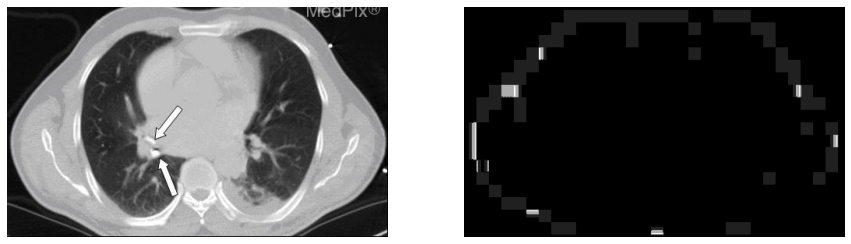

In [9]:
a = getRandomImage(color_imgs)
showChannelVar(a)

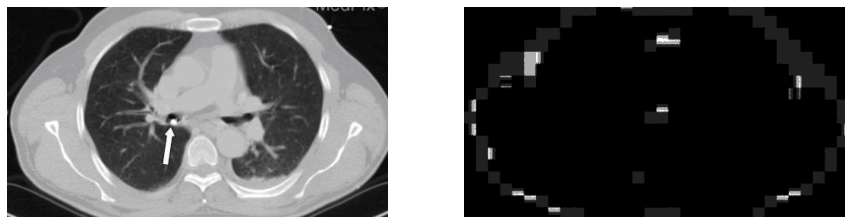

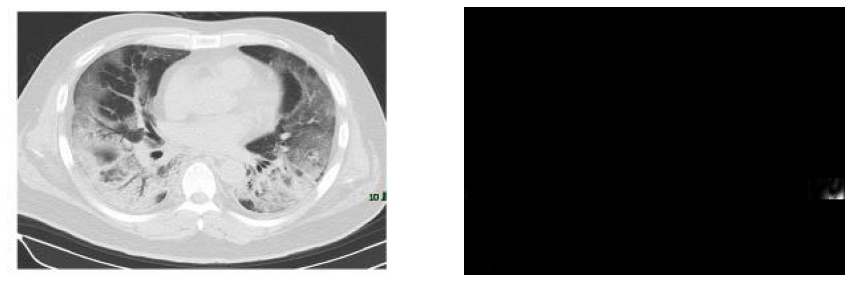

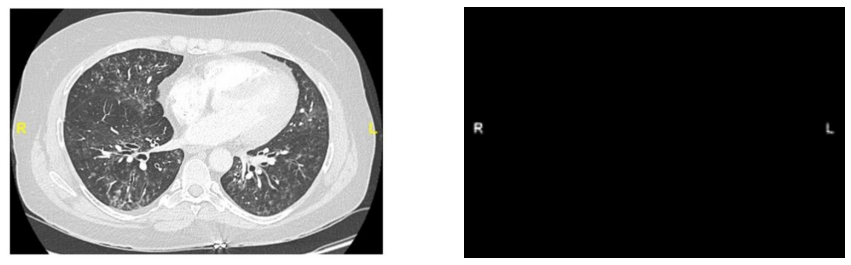

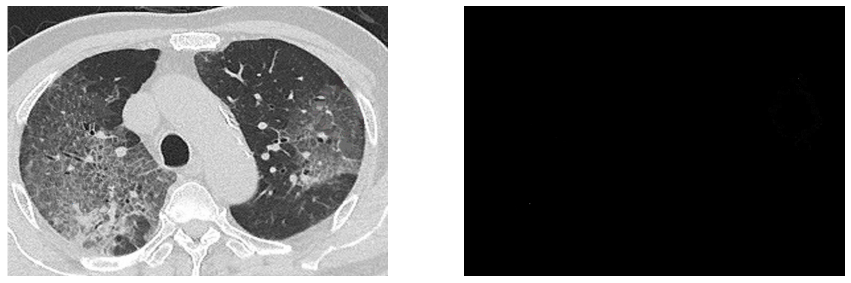

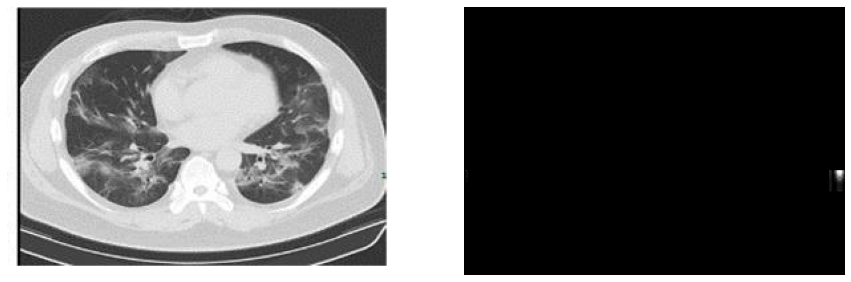

...

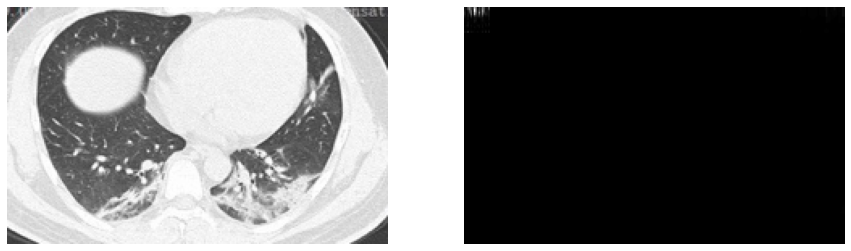

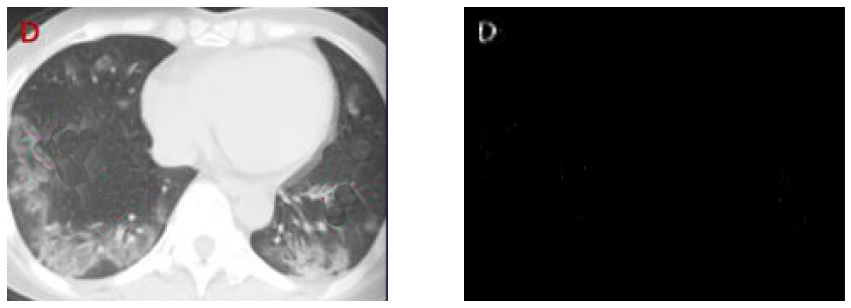

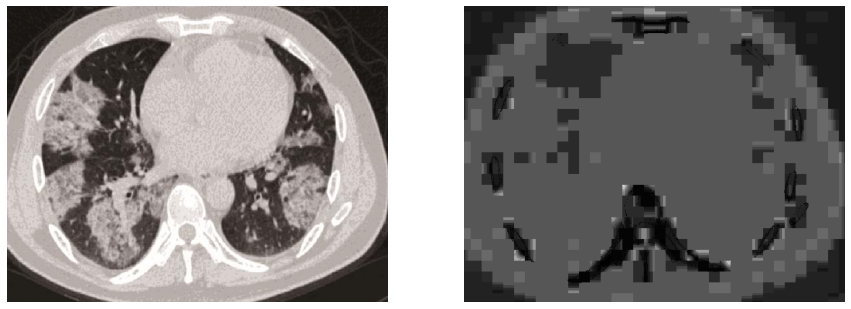

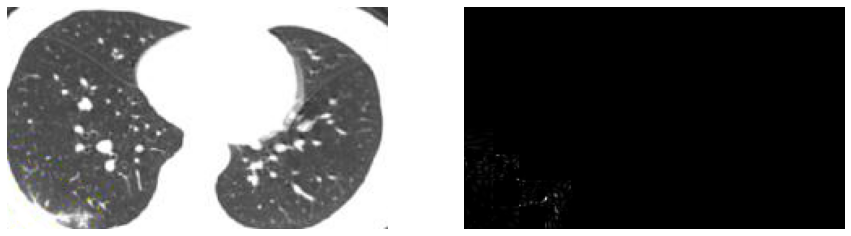

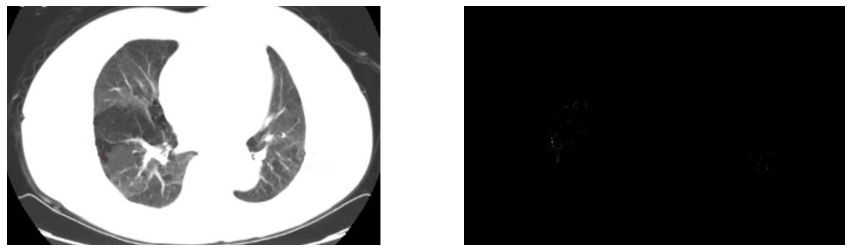

In [18]:
for img_path in color_imgs:     
    img = Image.open(img_path)
    showChannelVar(img)

In [11]:
def showFormats(img_paths):

    formats = []

    for img_path in img_paths:
        img = Image.open(img_path)
        formats.append(img.format)

    (unique_formats, counts) = np.unique(np.array(formats), return_counts = True)

    print(unique_formats)
    print(counts)
    
showFormats(covid_img_paths)
showFormats(non_covid_img_paths)

['JPEG' 'PNG']
[ 34 315]
['JPEG' 'PNG']
[202 195]


In [12]:
aspect_ratios = []
widths = []
heights = []

for img_path in img_paths:
    img = Image.open(img_path)
    
    widths.append(img.size[0])
    heights.append(img.size[1])
    aspect_ratios.append(img.size[0]/img.size[1])
    
widths = np.array(widths)
heights = np.array(heights)
aspect_ratios = np.array(aspect_ratios)

In [13]:
def printStats(x,name):
    print(f"{name}:")
    print(f"Min: {x.min():.2f}")
    print(f"Max: {x.max():.2f}")
    print(f"Average: {x.mean():.2f}")
    print(f"Median: {np.median(x):.2f}")
    print(f"std: {x.std():.2f}")
    print()

printStats(aspect_ratios, "Aspect ratio")
printStats(widths, "Width")
printStats(heights, "Height")

Aspect ratio:
Min: 0.94
Max: 2.43
Average: 1.44
Median: 1.42
std: 0.19

Width:
Min: 115.00
Max: 1671.00
Average: 425.48
Median: 407.00
std: 188.42

Height:
Min: 61.00
Max: 1225.00
Average: 302.55
Median: 291.00
std: 145.11



In [14]:
def fitLine(x_old,y_old):
    
    n = len(x_old)
    
    x = np.zeros( (n,2), dtype = np.float64 )
    x[:,0] = x_old
    x[:,1] = np.ones(n)
    y = np.array(y_old, dtype = np.float64).reshape( (n,1) )
    
    beta = np.linalg.inv(x.T@x)@x.T@y
    
    y_hat = x@beta
    
    print(f"LSR aspect ratio: {1/beta[0][0]:.2f}")
    
    return y_hat

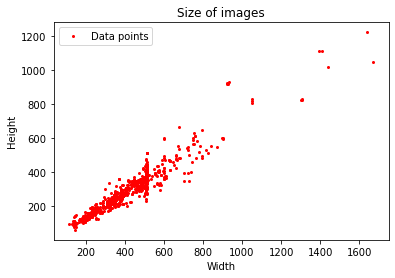

LSR aspect ratio: 1.36


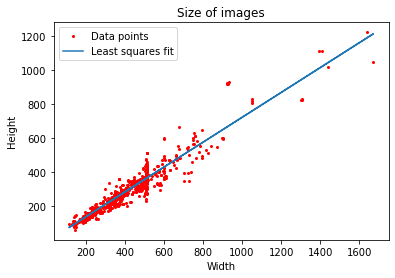

In [15]:
def plotSizes(widths,heights, LSR = False):
    fig, ax = plt.subplots()

    ax.set_title("Size of images")
    ax.set_xlabel("Width")
    ax.set_ylabel("Height")

    ax.plot(widths, heights,"ro", ms = "2", label = "Data points" )
    
    if LSR:
        y_hat = fitLine(widths,heights)
        ax.plot(widths, y_hat, label = "Least squares fit")

    plt.legend()
    plt.show()
    
plotSizes(widths,heights)
plotSizes(widths,heights,LSR = True)